<a href="https://colab.research.google.com/github/hsu607/BDA/blob/main/gangseogu_visualization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# matplotlib 한글 깨짐 방지   (이거 돌리고 런타임 다시시작 후 이건 돌리지 말고 아래 코드셀 돌리기)
!sudo apt-get install -y fonts-nanum
!sudo fc-cache -fv
!rm ~/.cache/matplotlib -rf

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following NEW packages will be installed:
  fonts-nanum
0 upgraded, 1 newly installed, 0 to remove and 23 not upgraded.
Need to get 9,599 kB of archives.
After this operation, 29.6 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu focal/universe amd64 fonts-nanum all 20180306-3 [9,599 kB]
Fetched 9,599 kB in 0s (24.2 MB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 76, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype
dpkg-preconfigure: unable to re-open stdin: 
Selecting previously unselected package fonts-nanum.
(Reading database ... 128276 files and dir

In [ ]:
#matplotlib 한글 깨짐 방지
import matplotlib.pyplot as plt
plt.rc('font', family='NanumBarunGothic') 

# 주차 데이터

## 강서구 동별 주차 데이터 시각화 그래프

In [ ]:
import pandas as pd

df = pd.read_csv("/content/drive/MyDrive/BDA 공모전/경찰청치안데이터/강서구 빅데이터 공모전/1. 교통관련/1. 수집 데이터/강서구 데이터 통합.csv")

In [ ]:
df_new = df.copy()
df_new['행정동명'] = df_new['행정동명'].str.replace('서울특별시 강서구 ', '')
df_new

,행정동명,경도,위도,등록대수,주차면수,공영주차면수,민영주차면수,건축물부설주차면수,노외주차면수,노상주차면수,초과수요,불법주정차,세대수,인구수,음식업종,소매업종
0,가양1동,126.834347,37.573101,25200,20668,125,20543,20543,0,125,4532,66500,20752,34359,1407,622
1,가양2동,126.854007,37.568657,4028,13600,214,13386,13386,11,203,-9572,23200,8121,13902,63,88
2,가양3동,126.862297,37.562682,6113,9611,254,9357,9357,110,144,-3498,13559,7791,14678,40,74
3,공항동,126.794957,37.556491,11752,17670,150,17520,17344,176,150,-5918,128582,13958,30927,337,295
4,등촌1동,126.859633,37.555856,9130,12732,537,12195,12180,443,109,-3602,32744,14012,24991,334,220
5,등촌2동,126.860025,37.545736,6853,6412,513,5899,5899,59,454,441,23591,8587,19855,110,107
6,등촌3동,126.846339,37.561055,8933,9879,304,9575,9545,129,205,-946,33610,15093,30025,358,477
7,발산1동,126.825577,37.550447,13878,8090,376,7714,7696,156,238,5788,63810,13438,36236,574,565
8,방화1동,126.817550,37.568643,15154,14487,704,13783,13731,382,374,667,44660,17352,42851,415,396
9,방화2동,126.804506,37.583804,10023,8322,521,7801,7789,421,112,1701,37069,12124,23371,300,456


In [ ]:
# !pip install ydata-profiling  --quiet

# import pandas as pd

# import ydata_profiling
# from ydata_profiling import ProfileReport

# import warnings
# warnings.filterwarnings('ignore')

# profile = ProfileReport(df , title="Profile Report")

# profile

In [ ]:
df_new['인구수']/df_new['세대수']

0     1.655696
1     1.711858
2     1.883969
3     2.215719
4     1.783543
5     2.312216
6     1.989333
7     2.696532
8     2.469514
9     1.927664
10    1.996811
11    2.520618
12    2.646282
13    1.859792
14    2.158898
15    2.213649
16    2.106160
17    1.930495
18    2.061555
19    1.953791
dtype: float64

/usr/local/lib/python3.9/dist-packages/IPython/core/pylabtools.py:128: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


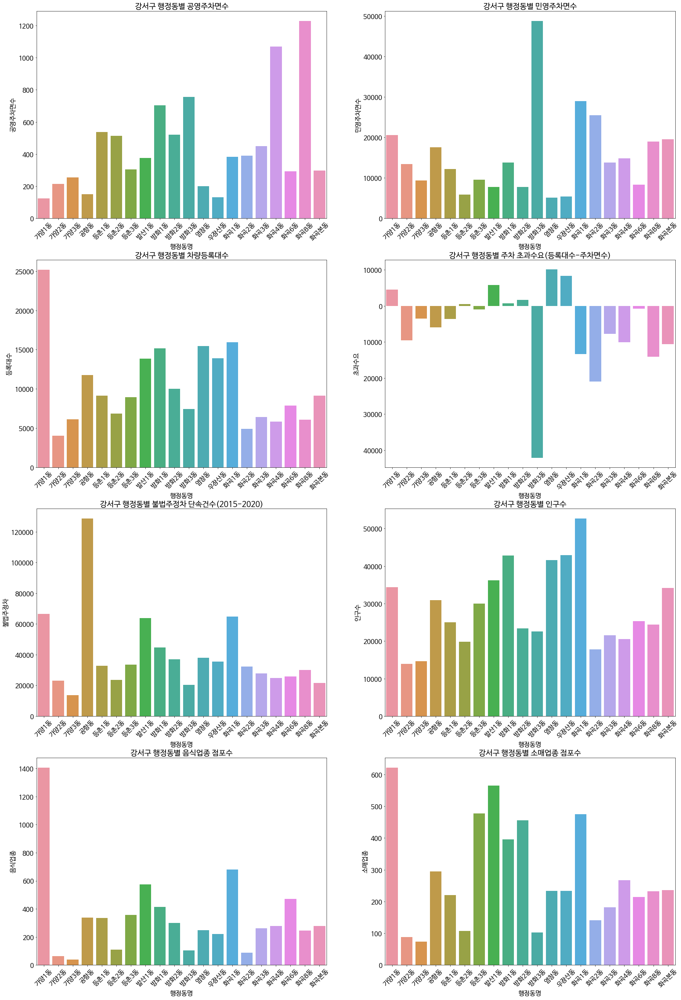

In [ ]:
# 변수별 barplot

import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize = (30,46))
plt.rc('font', size=17)

plt.subplot(4,2,1)
sns.barplot(df_new, x = '행정동명', y = '공영주차면수')
plt.xticks(rotation = 45)
plt.title('강서구 행정동별 공영주차면수')

plt.subplot(4,2,2)
sns.barplot(df_new, x = '행정동명', y = '민영주차면수')
plt.xticks(rotation = 45)
plt.title('강서구 행정동별 민영주차면수')

plt.subplot(4,2,3)
sns.barplot(df_new, x = '행정동명', y = '등록대수')
plt.xticks(rotation = 45)
plt.title('강서구 행정동별 차량등록대수')

plt.subplot(4,2,4)
sns.barplot(df_new, x = '행정동명', y = '초과수요')  # 양의 값이면 주차장이 부족하다는 것이고, 음의 값이면 주차장 여유가 있다는 것
plt.xticks(rotation = 45)
plt.title('강서구 행정동별 주차 초과수요(등록대수-주차면수)')

plt.subplot(4,2,5)
sns.barplot(df_new, x = '행정동명', y = '불법주정차')
plt.xticks(rotation = 45)
plt.title('강서구 행정동별 불법주정차 단속건수(2015-2020)')

plt.subplot(4,2,6)
sns.barplot(df_new, x = '행정동명', y = '인구수')
plt.xticks(rotation = 45)
plt.title('강서구 행정동별 인구수')

plt.subplot(4,2,7)
sns.barplot(df_new, x = '행정동명', y = '음식업종')
plt.xticks(rotation = 45)
plt.title('강서구 행정동별 음식업종 점포수')

plt.subplot(4,2,8)
sns.barplot(df_new, x = '행정동명', y = '소매업종')
plt.xticks(rotation = 45)
plt.title('강서구 행정동별 소매업종 점포수')

plt.show()

/usr/local/lib/python3.9/dist-packages/seaborn/utils.py:80: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from current font.
  fig.canvas.draw()


<Axes: title={'center': 'Correlation Heatmap'}>

/usr/local/lib/python3.9/dist-packages/IPython/core/events.py:88: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from current font.
  func(*args, **kwargs)
/usr/local/lib/python3.9/dist-packages/IPython/core/pylabtools.py:128: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


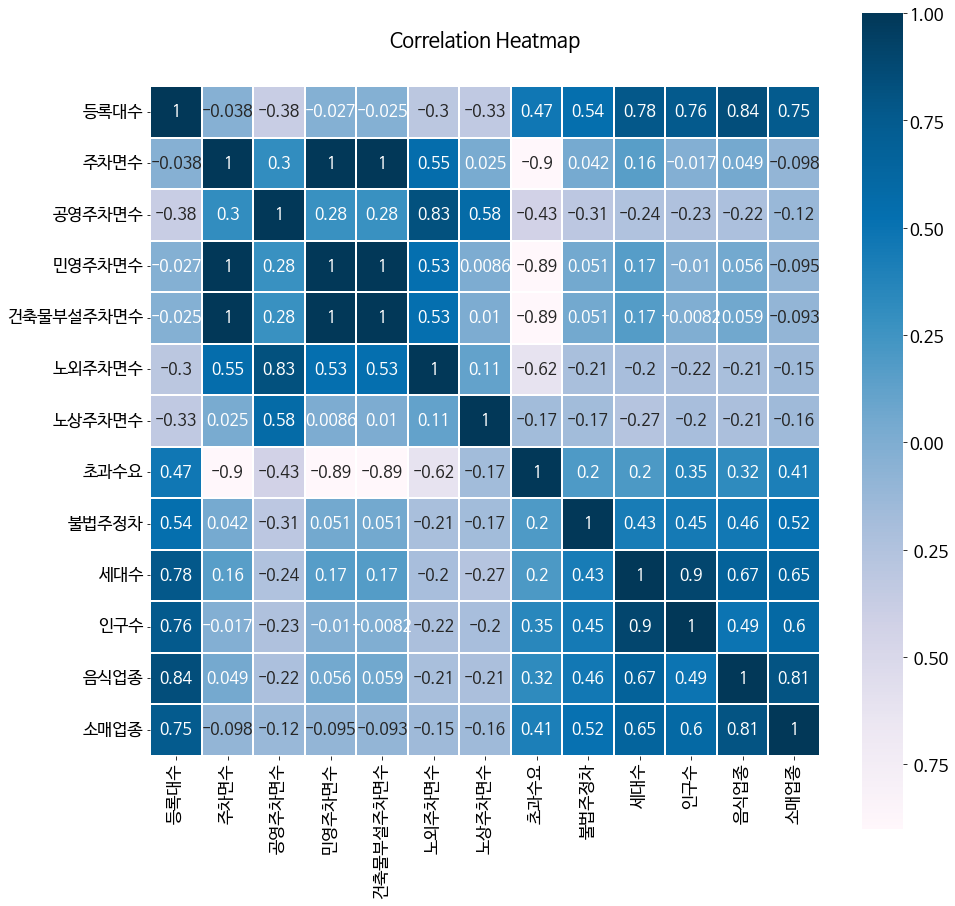

In [ ]:
# 변수별 correlation heatmap
colormap = plt.cm.PuBu
plt.figure(figsize=(15, 15))
plt.title("Correlation Heatmap", y = 1.05, size = 20)
sns.heatmap(df_new.iloc[:,3:].astype(float).corr(), linewidths = 0.1, vmax = 1.0,
           square = True, cmap = colormap, linecolor = "white", annot = True, annot_kws = {"size" : 16})

## 강서구 동별 주차 데이터 지도시각화

In [ ]:
# 필요한 라이브러리 import 
# json파일 불러오기

import os, json
import pandas as pd
import plotly.express as px
!git clone https://github.com/raqoon886/Local_HangJeongDong.git
os.chdir('./Local_HangJeongDong')

with open('./hangjeongdong_서울특별시.geojson', 'r') as f:
    seoul_geo = json.load(f)
    
df = pd.read_csv("/content/drive/MyDrive/BDA 공모전/경찰청치안데이터/강서구 빅데이터 공모전/1. 교통관련/1. 수집 데이터/강서구 데이터 통합.csv")

Cloning into 'Local_HangJeongDong'...
remote: Enumerating objects: 59, done.
remote: Counting objects: 100% (59/59), done.
remote: Compressing objects: 100% (43/43), done.
remote: Total 59 (delta 28), reused 44 (delta 16), pack-reused 0
Unpacking objects: 100% (59/59), 11.22 MiB | 3.48 MiB/s, done.


In [ ]:
seoul_geo

{'type': 'FeatureCollection',
 'name': 'temp',
 'crs': {'type': 'name',
  'properties': {'name': 'urn:ogc:def:crs:OGC:1.3:CRS84'}},
 'features': [{'type': 'Feature',
   'properties': {'OBJECTID': 1,
    'adm_nm': '서울특별시 종로구 사직동',
    'adm_cd': '1101053',
    'adm_cd2': '1111053000',
    'sgg': '11110',
    'sido': '11',
    'sidonm': '서울특별시',
    'sggnm': '종로구'},
   'geometry': {'type': 'MultiPolygon',
    'coordinates': [[[[126.97688884274817, 37.575650779448786],
       [126.9770344988775, 37.56919453005455],
       [126.97597472821249, 37.569336299425764],
       [126.97537470991254, 37.56931556702156],
       [126.97433193562325, 37.56926180051753],
       [126.96904837001854, 37.568194417708334],
       [126.96854493603384, 37.56842767961276],
       [126.9666499598212, 37.56949165520658],
       [126.96628175024485, 37.5697007347987],
       [126.9660973270804, 37.5698565097237],
       [126.96572852922577, 37.570183936115114],
       [126.96592699822128, 37.5703188056862],
     

In [ ]:
fig = px.choropleth_mapbox(df,
                           geojson=seoul_geo,
                           locations='행정동명',
                           color='주차면수',
                           color_continuous_scale='viridis', featureidkey = 'properties.adm_nm',
                           mapbox_style='carto-positron',
                           zoom=11,
                           center = {"lat": 37.563383, "lon": 126.84},
                           opacity=0.8,
                          )

fig

In [ ]:
# 방화3동 민영주차면수 매우 많음 ... 왜지
df[df['행정동명']=='서울특별시 강서구 방화3동']

,행정동명,경도,위도,등록대수,주차면수,공영주차면수,민영주차면수,건축물부설주차면수,노외주차면수,노상주차면수,초과수요,불법주정차,세대수,인구수,음식업종,소매업종
10,서울특별시 강서구 방화3동,126.815534,37.581585,7419,49535,755,48780,48324,1096,115,-42116,20454,11290,22544,103,103


In [ ]:
fig = px.choropleth_mapbox(df,
                           geojson=seoul_geo,
                           locations='행정동명',
                           color='인구수',
                           color_continuous_scale='Rdpu', featureidkey = 'properties.adm_nm',
                           mapbox_style='carto-positron',
                           zoom=11.5,
                           center = {"lat": 37.563383, "lon": 126.84},
                           opacity=0.7,
                          )

fig

In [ ]:
fig = px.choropleth_mapbox(df,
                           geojson=seoul_geo,
                           locations='행정동명',
                           color='초과수요',
                           color_continuous_scale='Rdpu', featureidkey = 'properties.adm_nm',
                           mapbox_style='carto-positron',
                           zoom=11.5,
                           center = {"lat": 37.563383, "lon": 126.84},
                           opacity=0.7,
                          )

fig

In [ ]:
token = "pk.eyJ1IjoiaHN1NjA3IiwiYSI6ImNsZmRzbzg1cjBqZW4zcG5tMHRxbmFvdGkifQ.LPFbin-JnWZyUt12jnAtVg"

import plotly.graph_objects as go

fig = go.Figure(go.Choroplethmapbox(geojson=seoul_geo, locations=df.행정동명, z=df.인구수,
                                    colorscale="Viridis", zmin=10000, zmax=50000, featureidkey = 'properties.adm_nm', marker_line_width=0))
fig.update_layout(mapbox_style="light", mapbox_accesstoken=token,
                  mapbox_zoom=11, mapbox_center = {"lat": 37.563383, "lon": 126.84})
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

In [ ]:
import folium
from folium.features import DivIcon

g_map = folium.Map(location=[37.563383, 126.84], tiles = 'openstreetmap', zoom_start=13)

folium.Choropleth(geo_data=seoul_geo,
                  data=df,
                  columns=['행정동명','주차면수'],
                  fill_color='Reds',
                  key_on='feature.properties.adm_nm',
                  line_color='dimgrey',
                  line_weight=4,
                  fill_opacity=0.7,
                  legend_name='강서구 행정동별 주차면수').add_to(g_map)

for name, lat, lng, value in zip(df['행정동명'], df['위도'], df['경도'], df['주차면수']):
  folium.map.Marker([lat, lng], 
                    icon = DivIcon(icon_size=(0,0), icon_anchor=(10,40),
          html='<div style="font-size:13pt; color:white; font-weight:bold; writing-mode: horizontal-tb; position:absolute; text-shadow: -2px 0 dimgrey, 0 2px dimgrey, 2px 0 dimgrey, 0 -2px dimgrey;">%s</div>' % name),
          popup=folium.Popup('<div style="font-size:10pt; font-weight:bold;">%s</div>' %('주차면수: ' + str(value)), max_width=200)).add_to(g_map)


g_map

# 범죄 데이터

## 서울시 구별 범죄 데이터 전처리

In [ ]:
import pandas as pd
# 서울시 구별 위치 정보 데이터
seoul_xy = pd.read_csv('/content/drive/MyDrive/BDA 공모전/경찰청치안데이터/강서구 빅데이터 공모전/1. 교통관련/2. 수집 데이터 전처리/서울특별시 구별 위치 정보.csv', encoding= 'cp949')

# 범죄 통합 데이터 
df1 = pd.read_csv('/content/drive/MyDrive/BDA 공모전/경찰청치안데이터/강서구 빅데이터 공모전/1. 교통관련/2. 수집 데이터 전처리/범죄발생+안전지표+소득데이터2016~2021.csv')
df1.연도.value_counts() # 2016~2021년(6년치 데이터)

2016    25
2017    25
2018    25
2019    25
2020    25
2021    25
Name: 연도, dtype: int64

In [ ]:
df1.loc[df1['자치구'] == '강서구', ['자치구','연도','총발생']]

,자치구,연도,총발생
15,강서구,2016,5450
40,강서구,2017,5135
65,강서구,2018,4629
90,강서구,2019,4924
115,강서구,2020,4415
140,강서구,2021,3896


In [ ]:
df1_mean = df1.groupby(by = '자치구').mean().round().astype(int).drop('연도', axis = 1)  # 최근 6년간 자치구별 연평균 데이터로 변환 
df1_mean = pd.merge(left = df1_mean, right = seoul_xy, left_on = '자치구', right_on = '행정구역')  # 자치구별 위도 경도 좌표 추가 
df1_mean.columns

Index(['총발생', '살인발생', '강도발생', '강간·강제추행발생', '절도발생', '폭력발생', '교통사고', '화재', '범죄',
       '생활안전', '자살', '감염병', 'cctv설치개수', 'cctv개수', '급여총계인원', '급여총계금액',
       '과세대상총급여인원', '과세대상총급여금액', '행정구역', '경도', '위도'],
      dtype='object')

In [ ]:
df1_mean.groupby('행정구역')['총발생'].sum().rank(ascending = False)

행정구역
강남구      1.0
강동구     12.0
강북구     19.0
강서구      5.0
관악구      4.0
광진구     10.0
구로구      8.0
금천구     21.0
노원구     11.0
도봉구     25.0
동대문구    14.0
동작구     20.0
마포구      6.0
서대문구    23.0
서초구      7.0
성동구     24.0
성북구     22.0
송파구      3.0
양천구     17.0
영등포구     2.0
용산구     18.0
은평구     15.0
종로구     16.0
중구      13.0
중랑구      9.0
Name: 총발생, dtype: float64

In [ ]:
ind = df1_mean.groupby('행정구역')['총발생'].sum().to_frame().sort_values(by = '총발생', ascending = False)
ind

,총발생
행정구역,
강남구,7365
영등포구,5558
송파구,5549
관악구,5210
강서구,4742
마포구,4732
서초구,4704
구로구,4573
중랑구,4184


Text(0.5, 1.0, '서울시 자치구별 범죄 총발생수')

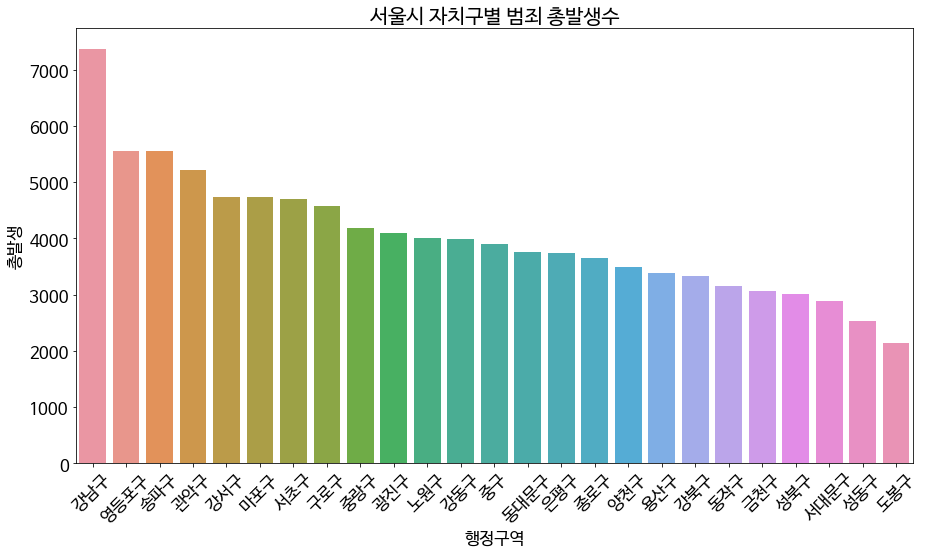

In [ ]:
sorted = df1_mean.groupby('행정구역')['총발생'].sum().to_frame().sort_values(by = '행정구역')
plt.figure(figsize = (15,8))
sns.barplot(ind, x = ind.index, y = '총발생')
plt.xticks(rotation = 45)
plt.title('서울시 자치구별 범죄 총발생수')

## 서울시 구별 범죄 데이터 지도시각화

In [ ]:
# 서울시 자치구별 범죄 총발생수

import folium
from folium.features import DivIcon

seoul_map1 = folium.Map(location=[37.563383, 127], zoom_start=12) #[위도,경도] 입력 후 확대 비율 설정

korea = '/content/drive/MyDrive/BDA 공모전/경찰청치안데이터/강서구 빅데이터 공모전/1. 교통관련/1. 수집 데이터/korea_map (2).json'
seoul_map1.choropleth(geo_data=korea,fill_color='grey',fill_opacity=0.5,line_color='grey',line_opacity=0.1)

state_geo = '/content/drive/MyDrive/BDA 공모전/경찰청치안데이터/강서구 빅데이터 공모전/1. 교통관련/1. 수집 데이터/seoul_map.json'

seoul_map1.choropleth(geo_data=state_geo,
                  data=df1_mean,
                  columns=['행정구역','총발생'],
                  fill_color='Reds',
                  key_on='feature.properties.SIG_KOR_NM',
                  line_color='dimgrey',
                  line_weight=4,
                  fill_opacity=0.8,
                  legend_name='서울시 자치구별 범죄 총발생수')

for name, lat, lng, value in zip(df1_mean['행정구역'], df1_mean['위도'], df1_mean['경도'],  df1_mean['총발생']):
  folium.map.Marker(
      [lat, lng],
      icon = DivIcon(
          icon_size=(0,0),
          icon_anchor=(10,40),
          html='<div style="font-size:13pt; color:white; font-weight:bold; writing-mode:lr; position:absolute; text-shadow: -2px 0 dimgrey, 0 2px dimgrey, 2px 0 dimgrey, 0 -2px dimgrey;">%s</div>' % name),
      popup=folium.Popup('<div style="font-size:13pt; font-weight:bold;">%s</div>' %('총 범죄 발생수: ' + str(value)), max_width=200)).add_to(seoul_map1)
    
seoul_map1

In [ ]:
# 서울시 자치구별 폭력범죄 발생수

import folium
from folium.features import DivIcon

seoul_map1 = folium.Map(location=[37.563383, 127], zoom_start=12) #[위도,경도] 입력 후 확대 비율 설정

korea = '/content/drive/MyDrive/BDA 공모전/경찰청치안데이터/강서구 빅데이터 공모전/1. 교통관련/1. 수집 데이터/korea_map (2).json'
seoul_map1.choropleth(geo_data=korea,fill_color='grey',fill_opacity=0.5,line_color='grey',line_opacity=0.1)

state_geo = '/content/drive/MyDrive/BDA 공모전/경찰청치안데이터/강서구 빅데이터 공모전/1. 교통관련/1. 수집 데이터/seoul_map.json'

seoul_map1.choropleth(geo_data=state_geo,
                  data=df1_mean,
                  columns=['행정구역','폭력발생'],
                  fill_color='PuRd',
                  key_on='feature.properties.SIG_KOR_NM',
                  line_color='dimgrey',
                  line_weight=4,
                  fill_opacity=0.8,
                  legend_name='서울시 자치구별 폭력범죄 발생수')

for name, lat, lng, value in zip(df1_mean['행정구역'], df1_mean['위도'], df1_mean['경도'],  df1_mean['폭력발생']):
  folium.map.Marker(
      [lat, lng],
      icon = DivIcon(
          icon_size=(0,0),
          icon_anchor=(10,40),
          html='<div style="font-size:13pt; color:white; font-weight:bold; writing-mode:lr; position:absolute; text-shadow: -2px 0 dimgrey, 0 2px dimgrey, 2px 0 dimgrey, 0 -2px dimgrey;">%s</div>' % name),
      popup=folium.Popup('<div style="font-size:13pt; font-weight:bold;">%s</div>' %('폭력범죄 발생수: ' + str(value)), max_width=200)).add_to(seoul_map1)
    
seoul_map1

In [ ]:
# 서울시 자치구별 절도범죄 발생수

import folium
from folium.features import DivIcon

seoul_map1 = folium.Map(location=[37.563383, 127], zoom_start=12) #[위도,경도] 입력 후 확대 비율 설정

korea = '/content/drive/MyDrive/BDA 공모전/경찰청치안데이터/강서구 빅데이터 공모전/1. 교통관련/1. 수집 데이터/korea_map (2).json'
seoul_map1.choropleth(geo_data=korea,fill_color='grey',fill_opacity=0.5,line_color='grey',line_opacity=0.1)

state_geo = '/content/drive/MyDrive/BDA 공모전/경찰청치안데이터/강서구 빅데이터 공모전/1. 교통관련/1. 수집 데이터/seoul_map.json'

seoul_map1.choropleth(geo_data=state_geo,
                  data=df1_mean,
                  columns=['행정구역','절도발생'],
                  fill_color='Blues',
                  key_on='feature.properties.SIG_KOR_NM',
                  line_color='dimgrey',
                  line_weight=4,
                  fill_opacity=0.8,
                  legend_name='서울시 자치구별 절도범죄 발생수')

for name, lat, lng, value in zip(df1_mean['행정구역'], df1_mean['위도'], df1_mean['경도'],  df1_mean['절도발생']):
  folium.map.Marker(
      [lat, lng],
      icon = DivIcon(
          icon_size=(0,0),
          icon_anchor=(10,40),
          html='<div style="font-size:13pt; color:white; font-weight:bold; writing-mode:lr; position:absolute; text-shadow: -2px 0 dimgrey, 0 2px dimgrey, 2px 0 dimgrey, 0 -2px dimgrey;">%s</div>' % name),
      popup=folium.Popup('<div style="font-size:13pt; font-weight:bold;">%s</div>' %('절도범죄 발생수: ' + str(value)), max_width=200)).add_to(seoul_map1)
    
seoul_map1

In [ ]:
# 서울시 자치구별 살인범죄 발생수

import folium
from folium.features import DivIcon

seoul_map1 = folium.Map(location=[37.563383, 127], zoom_start=12) #[위도,경도] 입력 후 확대 비율 설정

korea = '/content/drive/MyDrive/BDA 공모전/경찰청치안데이터/강서구 빅데이터 공모전/1. 교통관련/1. 수집 데이터/korea_map (2).json'
seoul_map1.choropleth(geo_data=korea,fill_color='grey',fill_opacity=0.5,line_color='grey',line_opacity=0.1)

state_geo = '/content/drive/MyDrive/BDA 공모전/경찰청치안데이터/강서구 빅데이터 공모전/1. 교통관련/1. 수집 데이터/seoul_map.json'

seoul_map1.choropleth(geo_data=state_geo,
                  data=df1_mean,
                  columns=['행정구역','살인발생'],
                  fill_color='YlGn',
                  key_on='feature.properties.SIG_KOR_NM',
                  line_color='dimgrey',
                  line_weight=4,
                  fill_opacity=0.8,
                  legend_name='서울시 자치구별 살인범죄 발생수')

for name, lat, lng, value in zip(df1_mean['행정구역'], df1_mean['위도'], df1_mean['경도'],  df1_mean['살인발생']):
  folium.map.Marker(
      [lat, lng],
      icon = DivIcon(
          icon_size=(0,0),
          icon_anchor=(10,40),
          html='<div style="font-size:13pt; color:white; font-weight:bold; writing-mode:lr; position:absolute; text-shadow: -2px 0 dimgrey, 0 2px dimgrey, 2px 0 dimgrey, 0 -2px dimgrey;">%s</div>' % name),
      popup=folium.Popup('<div style="font-size:13pt; font-weight:bold;">%s</div>' %('살인범죄 발생수: ' + str(value)), max_width=200)).add_to(seoul_map1)
    
seoul_map1

In [ ]:
# 서울시 자치구별 cctv 개수

import folium
from folium.features import DivIcon

seoul_map1 = folium.Map(location=[37.563383, 127], zoom_start=12) #[위도,경도] 입력 후 확대 비율 설정

korea = '/content/drive/MyDrive/BDA 공모전/경찰청치안데이터/강서구 빅데이터 공모전/1. 교통관련/1. 수집 데이터/korea_map (2).json'
seoul_map1.choropleth(geo_data=korea,fill_color='grey',fill_opacity=0.5,line_color='grey',line_opacity=0.1)

state_geo = '/content/drive/MyDrive/BDA 공모전/경찰청치안데이터/강서구 빅데이터 공모전/1. 교통관련/1. 수집 데이터/seoul_map.json'

seoul_map1.choropleth(geo_data=state_geo,
                  data=df1_mean,
                  columns=['행정구역','cctv개수'],
                  fill_color='PuBuGn',
                  key_on='feature.properties.SIG_KOR_NM',
                  line_color='dimgrey',
                  line_weight=4,
                  fill_opacity=0.8,
                  legend_name='서울시 자치구별 cctv 개수')

for name, lat, lng, value in zip(df1_mean['행정구역'], df1_mean['위도'], df1_mean['경도'],  df1_mean['cctv개수']):
  folium.map.Marker(
      [lat, lng],
      icon = DivIcon(
          icon_size=(0,0),
          icon_anchor=(10,40),
          html='<div style="font-size:13pt; color:white; font-weight:bold; writing-mode:lr; position:absolute; text-shadow: -2px 0 dimgrey, 0 2px dimgrey, 2px 0 dimgrey, 0 -2px dimgrey;">%s</div>' % name),
      popup=folium.Popup('<div style="font-size:13pt; font-weight:bold;">%s</div>' %('cctv개수: ' + str(value)), max_width=200)).add_to(seoul_map1)
    
seoul_map1

## shp파일로 지도 그리기

In [ ]:
!apt install libspatialindex-dev
!pip install rtree
!pip install geopandas

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  libspatialindex-c6 libspatialindex6
The following NEW packages will be installed:
  libspatialindex-c6 libspatialindex-dev libspatialindex6
0 upgraded, 3 newly installed, 0 to remove and 19 not upgraded.
Need to get 340 kB of archives.
After this operation, 1,538 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu focal/universe amd64 libspatialindex6 amd64 1.9.3-1build1 [266 kB]
Get:2 http://archive.ubuntu.com/ubuntu focal/universe amd64 libspatialindex-c6 amd64 1.9.3-1build1 [58.3 kB]
Get:3 http://archive.ubuntu.com/ubuntu focal/universe amd64 libspatialindex-dev amd64 1.9.3-1build1 [16.0 kB]
Fetched 340 kB in 2s (176 kB/s)
Selecting previously unselected package libspatialindex6:amd64.
(Reading database ... 128208 files and directories currently installed.)
Preparing to unpack .../libspatialindex6_1.9.3-1b

In [ ]:
# import libaray and packages
!pip install geopandas
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt

# prepare and read data
F1 = '/content/drive/MyDrive/BDA 공모전/경찰청치안데이터/강서구 빅데이터 공모전/1. 교통관련/1. 수집 데이터//EMD_202302/emd.shp'
D1 = gpd.read_file(F1, encoding='cp949')
# ※ 주의 ※ .shp 파일 위치에 .dbf, .shx 파일도 모두 포함되어야 함

In [ ]:
D1.head()
# EMD_CD: 법정동코드

,EMD_CD,EMD_ENG_NM,EMD_KOR_NM,geometry
0,11110101,Cheongun-dong,청운동,"POLYGON ((953700.022 1954605.065, 953693.871 1..."
1,11110102,Singyo-dong,신교동,"POLYGON ((953233.465 1953996.984, 953235.183 1..."
2,11110103,Gungjeong-dong,궁정동,"POLYGON ((953560.228 1954257.466, 953561.190 1..."
3,11110104,Hyoja-dong,효자동,"POLYGON ((953519.843 1953890.785, 953518.489 1..."
4,11110105,Changseong-dong,창성동,"POLYGON ((953516.123 1953734.362, 953516.526 1..."


<AxesSubplot:>

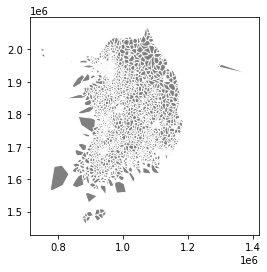

In [ ]:
D1.convex_hull.plot(color='gray', edgecolor="w")

In [ ]:
D1.info()   # 데이터 타입 확인

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 5065 entries, 0 to 5064
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   EMD_CD      5065 non-null   object  
 1   EMD_ENG_NM  5065 non-null   object  
 2   EMD_KOR_NM  5065 non-null   object  
 3   geometry    5065 non-null   geometry
dtypes: geometry(1), object(3)
memory usage: 158.4+ KB


In [ ]:
# extract seoul data from the orginal dataset
geo = D1.astype({ 'EMD_CD' : 'int' })   # 행정동코드 정수형(int)으로 변환
seoul = df1[df1['EMD_CD']<20000000]   # 서울의 법정동코드(EMD_CD)는 20,000,000 미만

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 5065 entries, 0 to 5064
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   EMD_CD      5065 non-null   int64   
 1   EMD_ENG_NM  5065 non-null   object  
 2   EMD_KOR_NM  5065 non-null   object  
 3   geometry    5065 non-null   geometry
dtypes: geometry(1), int64(1), object(2)
memory usage: 158.4+ KB


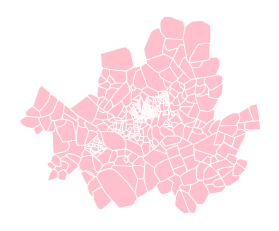

In [ ]:
# draw the seoul map
ax = seoul.convex_hull.plot(color='pink', edgecolor="w")          
ax.set_axis_off()              # 축제거
plt.show()

In [ ]:
seoul.crs= "+proj=longlat +ellps=WGS84 +datum=WGS84 +no_defs"
seoul.to_file('/content/drive/MyDrive/BDA 공모전/경찰청치안데이터/강서구 빅데이터 공모전/1. 교통관련/1. 수집 데이터/seoul.geojson', driver='ESRI Shapefile')

In [ ]:
# .shp 파일 geojson 파일로 변환함
import folium
from folium import plugins
import json 

dir = '/content/drive/MyDrive/BDA 공모전/경찰청치안데이터/강서구 빅데이터 공모전/1. 교통관련/1. 수집 데이터/seoul.zip.geojson'
seoul = json.load(open(dir, encoding = 'utf-8'))

In [ ]:
# 실패작 

g_map = folium.Map(location=[37.55,126.98], tiles = 'openstreetmap', zoom_start=12);g_map

folium.Choropleth(geo_data=seoul,
                  data=df,
                  columns=['행정동명','주차면수'],
                  fill_color='Reds',
                  key_on='feature.FID',
                  line_color='dimgrey',
                  line_weight=4,
                  fill_opacity=0.7,
                  legend_name='강서구 행정동별 주차면수').add_to(g_map)

g_map